**<span style="color:red">Namn och CID på gruppmedlemmar: </span>**

Blend Ahmed Omar (blend), Ebbe Ledin (ebbel), Albin Östling (ostlinga)


In [127]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
plt.style.use("ggplot")
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['animation.embed_limit'] = 2**128
from scipy import constants
c = constants.speed_of_light

In [128]:
#%% Funktioner för HUPP:en %%#

def fft2c(x):
    '''
    2D Fourier transform with shift!
    '''
    return np.fft.fftshift(np.fft.fft2(np.fft.fftshift(x)))

def ifft2c(x):
    '''
    2D inverse Fourier transform with shift!
    '''
    return np.fft.fftshift(np.fft.ifft2(np.fft.fftshift(x)))


def PAS(E1, L, N, a, lam0, n):
    '''
    Propagation of angular spectrum
    
    Precis samma som från HUPP1
    '''
    delta_k = 2*np.pi/(N*a)
    kx  = np.arange(-(N/2)*delta_k, (N/2)*delta_k, delta_k)
    ky  = kx
    KX, KY = np.meshgrid(kx,ky)
    
    k = 2*np.pi*n/lam0
    KZ = np.sqrt(k**2 - KX**2 - KY**2, dtype=complex)
    
    phase_prop = np.exp(1j*KZ*L)

    A = (a**2/(4*np.pi**2))*fft2c(E1)
    B = A*phase_prop
    E2 = (N*delta_k)**2*ifft2c(B)
    
    return E2

def nmat_GRIN(n_max, n_clad, D_core, X, Y):
    '''
    Skapar matris med brytningsindex för en graded-index fiber

    '''
    R = np.sqrt(X**2 + Y**2)
    const = (n_max-n_clad)/(D_core/2)**2
    return (R < (D_core/2))*(n_max-const*R**2)+(R >= (D_core/2))*n_clad

# Uppgift 1 - BPM-steget

#### Skriv klart funktionen!

In [129]:
def BPM_steg(E1, delta_z, N, a, lam0, Nmat, daempmat):
    '''
    Beam propagation method
    
    Funktionen är ej klar! Byt ut alla '.x.' för att få BPM funktionen att fungera

    '''
    
    k0            = 2*np.pi/lam0
    n_PAS         = np.mean(Nmat)
    E2_PAS        = PAS(E1, delta_z, N, a, lam0, n_PAS)
    faskorrektion = k0 * delta_z * (Nmat - n_PAS)
    
    return E2_PAS*np.exp(1j*faskorrektion)*daempmat

# Uppgift 2 - Singelmodfibern

#### **(a)** Kolla först hur det blir om du använder samma brytningsindex i kärna och hölje, $n_{clad} = 𝑛_{core}$. Då ska fältet inte vara guidat utan expandera vid propagationen, som förväntat i ett homogent medium. (Bry dig inte om att fältet kan se skumt ut efter att ha expanderat nästan ut till kanten av det numeriska fönstret, det är en effekt av normering i plotten och svaga numeriska reflektioner från daempmat; i verkligheten är fältet i stort sett noll här eftersom det försvunnit ut åt sidorna). <span style="background-color:yellow">Behöver ej redovisas!</span>

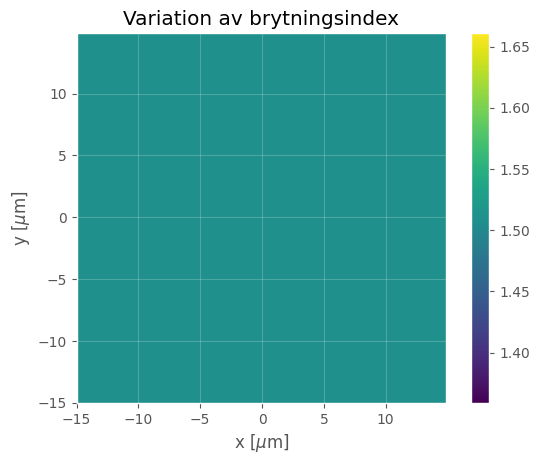

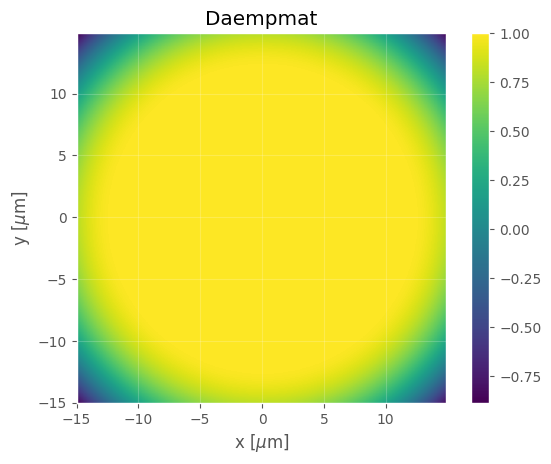

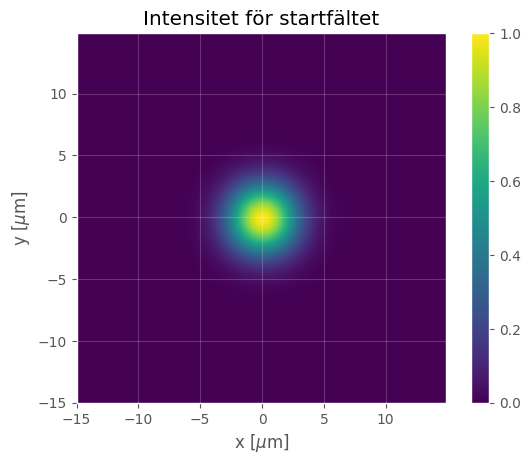

In [130]:
# Använd koden från uppgift b :)#%% Definiera variabler %%#
    
N               = 2**8                # Antal samplingspunkter
sidlaengd_Plan1 = 30e-6               # Sidlängd plan 1
a               = sidlaengd_Plan1/N   # Samplingsavstånd plan 1
 
omega0      = 4e-6                    # 1/e beam width [1/m]
lam0        = 1550e-9                 # Vågländ        [m]
k0          = 2*np.pi/lam0            # Vågvektor      [1/m]

### Definiera koordinater i plan 1 ###
x      = np.arange(-a*N/2, a*N/2, a)  
y      = x
[X, Y] = np.meshgrid(x, y)
R      = np.sqrt(X**2 + Y**2)         # Avståndet till origo för varje sampelpunkt

n_core = 1.51                         # Brytningsindex för kärnan av fibern
n_clad = 1.51                         # Brytningsindex för fiberns cladding
D_core = 3e-6                         # Tjockleck av kärnan

# Definiera variationen av brytningsindex för fibern
Nmat   = (R <= D_core/2)*n_core + (R > D_core/2)*n_clad


#%% Plotta variationen av brytningsindex %%#
x_um = x*1e6                          # Skala om till micrometer
y_um = y*1e6                          

plt.figure()
image = plt.imshow(Nmat, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

plt.colorbar(image)

plt.title(r'Variation av brytningsindex')
plt.xlabel(r'x $[\mu$m$]$')
plt.ylabel(r'y $[\mu$m$]$')
plt.grid(alpha=0.2)

#%% Plotta dämpningsmatrisen. Behöver ej ändras %%#

r_daemp_start = 0.8*N/2*a   # Fram till r_daemp sker ingen dämpning
kantvaerde    = 0.8         # Värdet av daempmat längs kanterna
daempmat      = (R <= r_daemp_start)*1 + (R > r_daemp_start)*(1-(1-kantvaerde)/(N/2*a-r_daemp_start)**2*(R-r_daemp_start)**2)

plt.figure()
image = plt.imshow(daempmat, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

plt.colorbar(image)

plt.title(r'Daempmat')
plt.xlabel(r'x $[\mu$m$]$')
plt.ylabel(r'y $[\mu$m$]$')
plt.grid(alpha=0.2)

#%% Definiera startfältet %%#

E_start       = np.exp(-(X**2 + Y**2)/omega0**2)
I_start       = np.abs(E_start)**2
I_start_norm  = I_start/np.max(I_start)


plt.figure()
image = plt.imshow(I_start_norm, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

plt.colorbar(image)

plt.title(r'Intensitet för startfältet')
plt.xlabel(r'x $[\mu$m$]$')
plt.ylabel(r'y $[\mu$m$]$')
plt.grid(alpha=0.2)

In [131]:
#%% Propagera med BPM och animera intensiteten (optimized version)

L       = 1000e-6                         # Total längd att propagera
delta_z = 2e-6                            # Steglängd för BPM
Lvekt   = np.arange(delta_z, L, delta_z)

### Definiera matriser för att spara fält ###
E1 = E_start
E_sida = np.zeros(shape=(N, len(Lvekt)), dtype=complex)
I_sida_norm = np.zeros(shape=(N, len(Lvekt)))

### Beräknar propagations tvärsnitt ###
print("Beräknar propagations tvärsnitten")
E_tvarsnitts = np.zeros(shape=(len(Lvekt), N, N), dtype=complex)

# Summera fält längs x-axeln för startfältet
E_start_laengs_yaxeln = E_start[:, int(N/2+1)]
I_start_laengs_yaxeln = np.abs(E_start_laengs_yaxeln)**2
I_start_laengs_yaxeln_norm = I_start_laengs_yaxeln/np.max(I_start_laengs_yaxeln)
I_sida_norm[:,0] = I_start_laengs_yaxeln_norm

for steg, L in enumerate(Lvekt):
    if steg % 100 == 0:
        print(f'Beräknar steg {steg+1} of {len(Lvekt)}')
    
    E2 = BPM_steg(E1, delta_z, N, a, lam0, Nmat, daempmat)      
    
    # Spara fält för visualisering
    E_tvarsnitts[steg] = E2 
    
    #Matriser för att plotta fältet sett från sidan
    E2_laengs_yaxeln = E2[:, int(N/2+1)]
    I2_laengs_yaxeln = np.abs(E2_laengs_yaxeln)**2
    if np.max(I2_laengs_yaxeln) > 0:  # Undvika division med noll
        I2_laengs_yaxeln_norm = I2_laengs_yaxeln/np.max(I2_laengs_yaxeln)
    else:
        I2_laengs_yaxeln_norm = I2_laengs_yaxeln
        
    E_sida[:,steg] = E2_laengs_yaxeln
    I_sida_norm[:,steg] = I2_laengs_yaxeln_norm
    
    # Uppdatera E-fält för nästa iteration 
    E1 = E2

# Skapa reducerat antal animations frames 
skip_frames = max(1, len(Lvekt) // 100)  # Show about 100 frames total
frame_indices = range(0, len(Lvekt), skip_frames)
print(f"Skapar {len(frame_indices)} animation frames")
I2_animation = []

# Definiera subplots 
fig, (ax1, ax2) = plt.subplots(2)
plt.subplots_adjust(wspace=0, hspace=0.5)

ax1.set_title(r'Tvärsnitt av intensitet')
ax1.set_xlabel(r'x [$\mu$m]')
ax1.set_ylabel(r'y [$\mu$m]')
ax1.grid(alpha=0.2)

ax2.set_title(r'Normalizerad intensitet längs y-axeln')
ax2.set_xlabel(r'z [mm]')
ax2.set_ylabel(r'y [$\mu$m]')
ax2.grid(alpha=0.2)

 # Skala om propagations längd till mm
Lvekt_mm = Lvekt*1e3

# Lägg till den första animations framen
I_start_norm = np.abs(E_start)**2/np.max(np.abs(E_start)**2)
im1 = ax1.imshow(I_start_norm, extent=[x_um.min(), x_um.max(), y_um.min(), y_um.max()])
im2 = ax2.imshow(I_sida_norm[:, :1], extent=[0, Lvekt_mm[0], y_um.min(), y_um.max()], aspect='auto')
I2_animation.append([im1, im2])

# Lägg till resterande frames
for i, idx in enumerate(frame_indices):
    if i % 20 == 0:
        print(f"Skapar frame {i+1} of {len(frame_indices)}")
        
    # Beräkna fölt för detta steget
    E2 = E_tvarsnitts[idx]
    I2 = np.abs(E2)**2
    I2_norm = I2/np.max(I2) if np.max(I2) > 0 else I2
    
    im1 = ax1.imshow(I2_norm, extent=[x_um.min(), x_um.max(), y_um.min(), y_um.max()])
    im2 = ax2.imshow(I_sida_norm[:, :(idx+1)], extent=[0, Lvekt_mm[idx], y_um.min(), y_um.max()], aspect='auto')
    
    I2_animation.append([im1, im2])

### Och till slut animera propagationen 
print("Skapar animation")
final_animation = animation.ArtistAnimation(fig,                 # Objekt för figur att plottas i 
                                            I2_animation,        # Bilder i animeringen
                                            interval     = 50,   # Delay mellan bilder i animering 
                                            blit         = True, # Aktivera blitting (Gör animeringen snyggare) 
                                            repeat_delay = 300)  # Delay till att animeringen upprepas
plt.close()

# Visa animationen!
final_animation

Beräknar propagations tvärsnitten
Beräknar steg 1 of 499
Beräknar steg 101 of 499
Beräknar steg 201 of 499
Beräknar steg 301 of 499
Beräknar steg 401 of 499
Skapar 125 animation frames
Skapar frame 1 of 125
Skapar frame 21 of 125
Skapar frame 41 of 125
Skapar frame 61 of 125
Skapar frame 81 of 125
Skapar frame 101 of 125
Skapar frame 121 of 125
Skapar animation


#### **(b)** Använd nu de korrekta värdena för brytningsindex och se vilken effekt den löjligt lilla skillnaden i brytningsindex har.

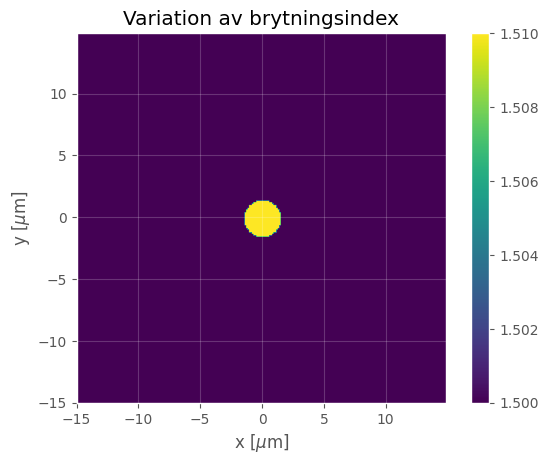

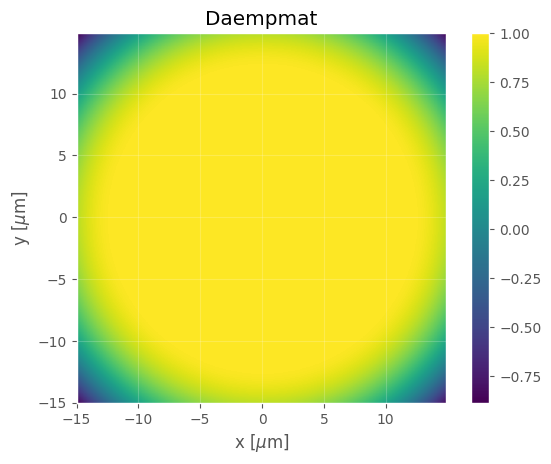

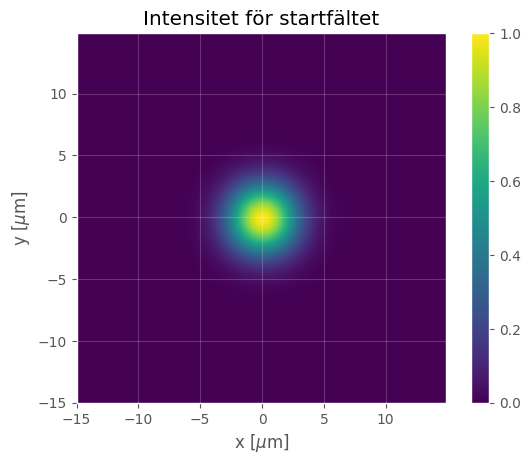

In [132]:
#%% Definiera variabler %%#
    
N               = 2**8                # Antal samplingspunkter
sidlaengd_Plan1 = 30e-6               # Sidlängd plan 1
a               = sidlaengd_Plan1/N   # Samplingsavstånd plan 1
 
omega0      = 4e-6                    # 1/e beam width [1/m]
lam0        = 1550e-9                 # Vågländ        [m]
k0          = 2*np.pi/lam0            # Vågvektor      [1/m]

### Definiera koordinater i plan 1 ###
x      = np.arange(-a*N/2, a*N/2, a)  
y      = x
[X, Y] = np.meshgrid(x, y)
R      = np.sqrt(X**2 + Y**2)         # Avståndet till origo för varje sampelpunkt

n_core = 1.51                         # Brytningsindex för kärnan av fibern
n_clad = 1.50                         # Brytningsindex för fiberns cladding
D_core = 3e-6                         # Tjockleck av kärnan

# Definiera variationen av brytningsindex för fibern
Nmat   = (R <= D_core/2)*n_core + (R > D_core/2)*n_clad


#%% Plotta variationen av brytningsindex %%#
x_um = x*1e6                          # Skala om till micrometer
y_um = y*1e6                          

plt.figure()
image = plt.imshow(Nmat, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

plt.colorbar(image)

plt.title(r'Variation av brytningsindex')
plt.xlabel(r'x $[\mu$m$]$')
plt.ylabel(r'y $[\mu$m$]$')
plt.grid(alpha=0.2)

#%% Plotta dämpningsmatrisen. Behöver ej ändras %%#

r_daemp_start = 0.8*N/2*a   # Fram till r_daemp sker ingen dämpning
kantvaerde    = 0.8         # Värdet av daempmat längs kanterna
daempmat      = (R <= r_daemp_start)*1 + (R > r_daemp_start)*(1-(1-kantvaerde)/(N/2*a-r_daemp_start)**2*(R-r_daemp_start)**2)

plt.figure()
image = plt.imshow(daempmat, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

plt.colorbar(image)

plt.title(r'Daempmat')
plt.xlabel(r'x $[\mu$m$]$')
plt.ylabel(r'y $[\mu$m$]$')
plt.grid(alpha=0.2)

#%% Definiera startfältet %%#

E_start       = np.exp(-(X**2 + Y**2)/omega0**2)
I_start       = np.abs(E_start)**2
I_start_norm  = I_start/np.max(I_start)


plt.figure()
image = plt.imshow(I_start_norm, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

plt.colorbar(image)

plt.title(r'Intensitet för startfältet')
plt.xlabel(r'x $[\mu$m$]$')
plt.ylabel(r'y $[\mu$m$]$')
plt.grid(alpha=0.2)

In [133]:
#%% Propagera med BPM och animera intensiteten (optimized version)

L       = 1000e-6                         # Total längd att propagera
delta_z = 2e-6                            # Steglängd för BPM
Lvekt   = np.arange(delta_z, L, delta_z)

### Definiera matriser för att spara fält ###
E1 = E_start
E_sida = np.zeros(shape=(N, len(Lvekt)), dtype=complex)
I_sida_norm = np.zeros(shape=(N, len(Lvekt)))

### Beräknar propagations tvärsnitt ###
print("Beräknar propagations tvärsnitten")
E_tvarsnitts = np.zeros(shape=(len(Lvekt), N, N), dtype=complex)

# Summera fält längs x-axeln för startfältet
E_start_laengs_yaxeln = E_start[:, int(N/2+1)]
I_start_laengs_yaxeln = np.abs(E_start_laengs_yaxeln)**2
I_start_laengs_yaxeln_norm = I_start_laengs_yaxeln/np.max(I_start_laengs_yaxeln)
I_sida_norm[:,0] = I_start_laengs_yaxeln_norm

for steg, L in enumerate(Lvekt):
    if steg % 100 == 0:
        print(f'Beräknar steg {steg+1} of {len(Lvekt)}')
    
    E2 = BPM_steg(E1, delta_z, N, a, lam0, Nmat, daempmat)      
    
    # Spara fält för visualisering
    E_tvarsnitts[steg] = E2 
    
    #Matriser för att plotta fältet sett från sidan
    E2_laengs_yaxeln = E2[:, int(N/2+1)]
    I2_laengs_yaxeln = np.abs(E2_laengs_yaxeln)**2
    if np.max(I2_laengs_yaxeln) > 0:  # Undvika division med noll
        I2_laengs_yaxeln_norm = I2_laengs_yaxeln/np.max(I2_laengs_yaxeln)
    else:
        I2_laengs_yaxeln_norm = I2_laengs_yaxeln
        
    E_sida[:,steg] = E2_laengs_yaxeln
    I_sida_norm[:,steg] = I2_laengs_yaxeln_norm
    
    # Uppdatera E-fält för nästa iteration 
    E1 = E2

# Skapa reducerat antal animations frames 
skip_frames = max(1, len(Lvekt) // 100)  # Show about 100 frames total
frame_indices = range(0, len(Lvekt), skip_frames)
print(f"Skapar {len(frame_indices)} animation frames")
I2_animation = []

# Definiera subplots 
fig, (ax1, ax2) = plt.subplots(2)
plt.subplots_adjust(wspace=0, hspace=0.5)

ax1.set_title(r'Tvärsnitt av intensitet')
ax1.set_xlabel(r'x [$\mu$m]')
ax1.set_ylabel(r'y [$\mu$m]')
ax1.grid(alpha=0.2)

ax2.set_title(r'Normalizerad intensitet längs y-axeln')
ax2.set_xlabel(r'z [mm]')
ax2.set_ylabel(r'y [$\mu$m]')
ax2.grid(alpha=0.2)

 # Skala om propagations längd till mm
Lvekt_mm = Lvekt*1e3

# Lägg till den första animations framen
I_start_norm = np.abs(E_start)**2/np.max(np.abs(E_start)**2)
im1 = ax1.imshow(I_start_norm, extent=[x_um.min(), x_um.max(), y_um.min(), y_um.max()])
im2 = ax2.imshow(I_sida_norm[:, :1], extent=[0, Lvekt_mm[0], y_um.min(), y_um.max()], aspect='auto')
I2_animation.append([im1, im2])

# Lägg till resterande frames
for i, idx in enumerate(frame_indices):
    if i % 20 == 0:
        print(f"Skapar frame {i+1} of {len(frame_indices)}")
        
    # Beräkna fölt för detta steget
    E2 = E_tvarsnitts[idx]
    I2 = np.abs(E2)**2
    I2_norm = I2/np.max(I2) if np.max(I2) > 0 else I2
    
    im1 = ax1.imshow(I2_norm, extent=[x_um.min(), x_um.max(), y_um.min(), y_um.max()])
    im2 = ax2.imshow(I_sida_norm[:, :(idx+1)], extent=[0, Lvekt_mm[idx], y_um.min(), y_um.max()], aspect='auto')
    
    I2_animation.append([im1, im2])

### Och till slut animera propagationen 
print("Skapar animation")
final_animation = animation.ArtistAnimation(fig,                 # Objekt för figur att plottas i 
                                            I2_animation,        # Bilder i animeringen
                                            interval     = 50,   # Delay mellan bilder i animering 
                                            blit         = True, # Aktivera blitting (Gör animeringen snyggare) 
                                            repeat_delay = 300)  # Delay till att animeringen upprepas
plt.close()

# Visa animationen!
final_animation

Beräknar propagations tvärsnitten
Beräknar steg 1 of 499
Beräknar steg 101 of 499
Beräknar steg 201 of 499
Beräknar steg 301 of 499
Beräknar steg 401 of 499
Skapar 125 animation frames
Skapar frame 1 of 125
Skapar frame 21 of 125
Skapar frame 41 of 125
Skapar frame 61 of 125
Skapar frame 81 of 125
Skapar frame 101 of 125
Skapar frame 121 of 125
Skapar animation


#### **(c)** Hur känslig är singelmodfibern för linjeringsfel?

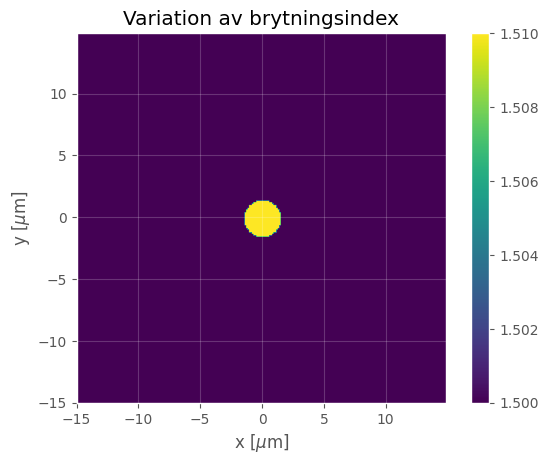

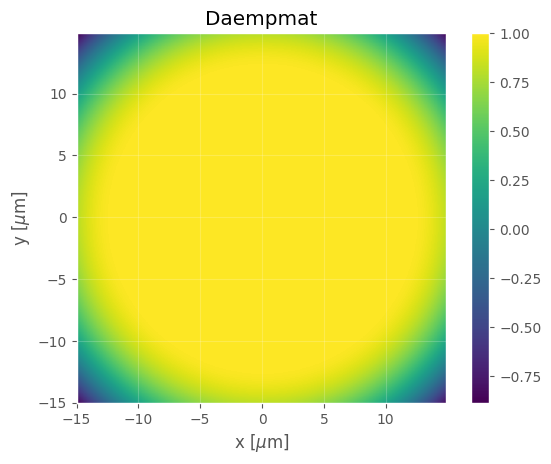

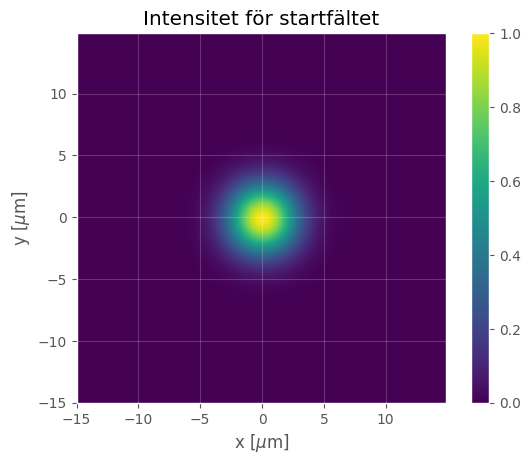

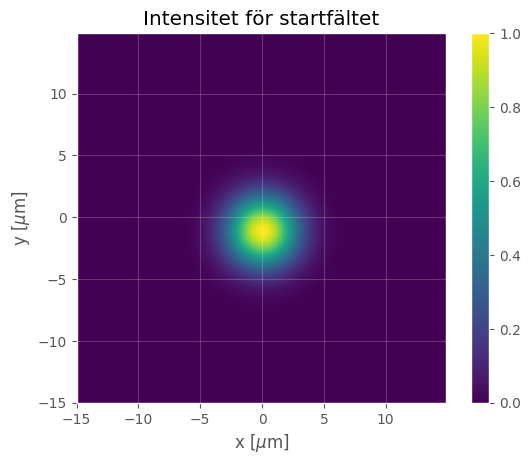

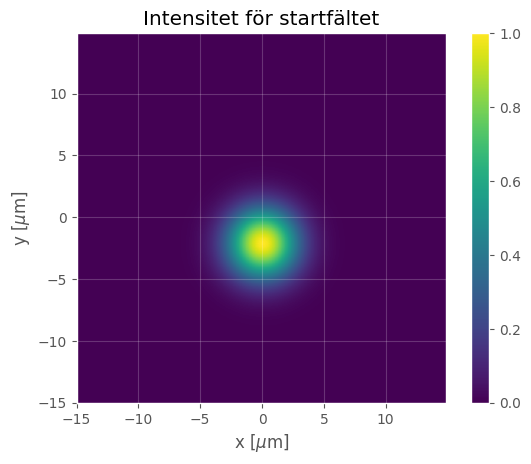

...

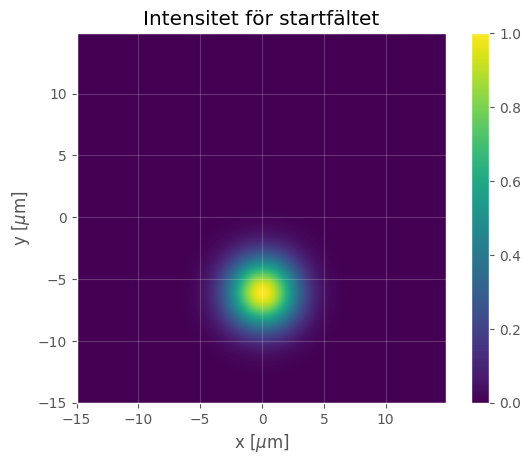

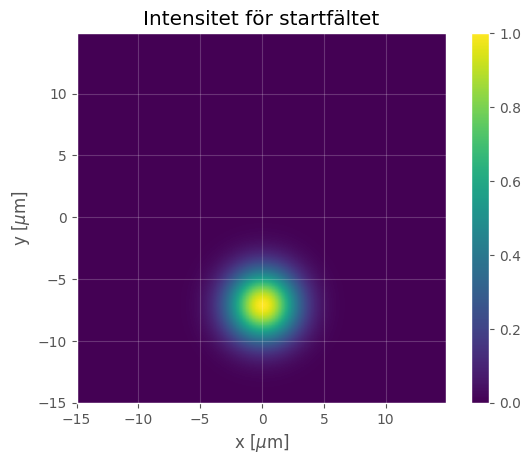

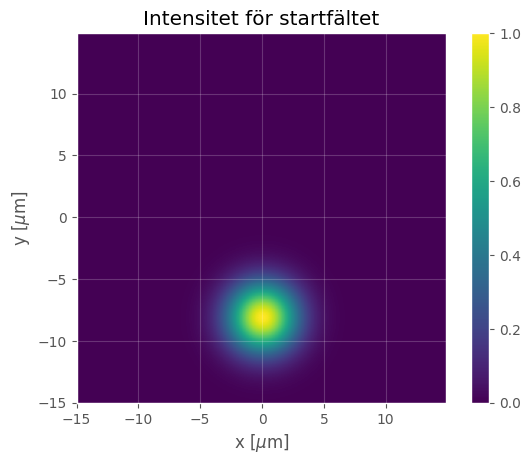

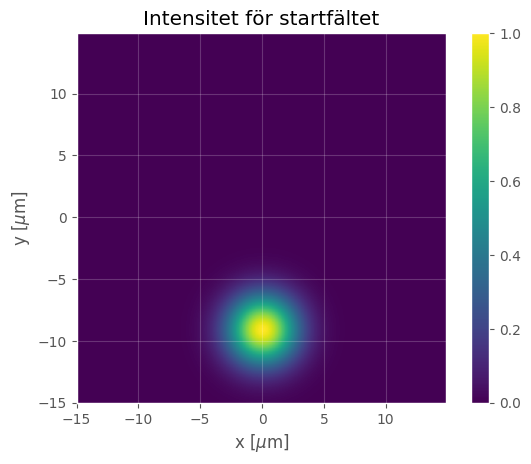

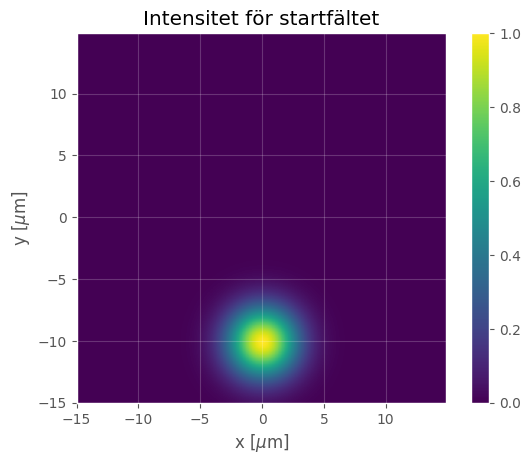

In [134]:
## Kod

#%% Definiera variabler %%#
delta_y = np.arange(0,10e-6,1e-6)
#np.arange(0,10e-6,1e-6)
    
N               = 2**8                # Antal samplingspunkter
sidlaengd_Plan1 = 30e-6               # Sidlängd plan 1
a               = sidlaengd_Plan1/N   # Samplingsavstånd plan 1
 
omega0      = 4e-6                    # 1/e beam width [1/m]
lam0        = 1550e-9                 # Vågländ        [m]
k0          = 2*np.pi/lam0            # Vågvektor      [1/m]

### Definiera koordinater i plan 1 ###
x      = np.arange(-a*N/2, a*N/2, a)  
y      = x
[X, Y] = np.meshgrid(x, y)
R      = np.sqrt(X**2 + Y**2)         # Avståndet till origo för varje sampelpunkt

n_core = 1.51                         # Brytningsindex för kärnan av fibern
n_clad = 1.50                         # Brytningsindex för fiberns cladding
D_core = 3e-6                         # Tjockleck av kärnan

# Definiera variationen av brytningsindex för fibern
Nmat   = (R <= D_core/2)*n_core + (R > D_core/2)*n_clad


#%% Plotta variationen av brytningsindex %%#
x_um = x*1e6                          # Skala om till micrometer
y_um = y*1e6                          

plt.figure()
image = plt.imshow(Nmat, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

plt.colorbar(image)

plt.title(r'Variation av brytningsindex')
plt.xlabel(r'x $[\mu$m$]$')
plt.ylabel(r'y $[\mu$m$]$')
plt.grid(alpha=0.2)

#%% Plotta dämpningsmatrisen. Behöver ej ändras %%#

r_daemp_start = 0.8*N/2*a   # Fram till r_daemp sker ingen dämpning
kantvaerde    = 0.8         # Värdet av daempmat längs kanterna
daempmat      = (R <= r_daemp_start)*1 + (R > r_daemp_start)*(1-(1-kantvaerde)/(N/2*a-r_daemp_start)**2*(R-r_daemp_start)**2)

plt.figure()
image = plt.imshow(daempmat, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

plt.colorbar(image)

plt.title(r'Daempmat')
plt.xlabel(r'x $[\mu$m$]$')
plt.ylabel(r'y $[\mu$m$]$')
plt.grid(alpha=0.2)

#%% Definiera startfältet %%#
for i in delta_y:
    E_start       = np.exp(-(X**2 + (Y-i)**2)/omega0**2)
    I_start       = np.abs(E_start)**2
    I_start_norm  = I_start/np.max(I_start)


    plt.figure()
    image = plt.imshow(I_start_norm, extent = [x_um.min(), x_um.max(), y_um.min(), y_um.max()])

    plt.colorbar(image)

    plt.title(r'Intensitet för startfältet')
    plt.xlabel(r'x $[\mu$m$]$')
    plt.ylabel(r'y $[\mu$m$]$')
    plt.grid(alpha=0.2)

#### **(d)** Du ta det komplexa fältet du beräknat med BPM och animera den verkliga fältfördelningen i tid. Om du kollar noga ser du att det tycks vara något fel på det animerade fältet. Försök t.ex. läsa av våglängden från en ögonblicksbild av det verkliga fältet och fundera på vilken riktning som vågfronterna borde propagera i. Vad är ”felet”? Kan du på något sätt få en korrekt animation med ett fält du genererar med ditt BPMprogram? (ledning: ändra BPM-steglängd)

In [135]:
#%% Animera det komplexa fältet i tid!

T           = lam0/c    # Periodtid
omega_frek = 2*np.pi/T  # Vinkelfrekvens
deltaT     = T/50       # Steg i tiden
antal_perioder = 2      # Antal periodtider att visa

t = np.arange(0, antal_perioder*T, deltaT)

I_sida_animation = []

fig, ax = plt.subplots()
ax.set_xlabel(r"x [$\mu$m]")
ax.set_ylabel(r"y [$\mu$m]")
plt.grid(alpha=0.2)


for i in range(len(t)):
    if i % 20 == 0:
        print(f"Skapar frame {i+1} of {len(t)}")
    E_sida_t = np.real(E_sida*np.exp(-1j*omega_frek*t[i]))
    I_sida_t = np.abs(E_sida_t)**2
    
    im = ax.imshow(I_sida_t, extent=[x_um.min(), x_um.max(), y_um.min(), y_um.max()])
    I_sida_animation.append([im])

print("Skapar animation")
final_animation_sida = animation.ArtistAnimation(fig,                 # Objekt för figur att plottas i 
                                                 I_sida_animation,    # Bilder i animeringen
                                                 interval     = 50,   # Delay mellan bilder i animering 
                                                 blit         = True, # Aktivera blitting (Gör animeringen snyggare) 
                                                 repeat_delay = 300)  # Delay till att animeringen upprepas

plt.close()
final_animation_sida

Skapar frame 1 of 100
Skapar frame 21 of 100
Skapar frame 41 of 100
Skapar frame 61 of 100
Skapar frame 81 of 100
Skapar animation


# Uppgift 3 - Multimodfibern



#### **(a)** Med fibern från uppgift 2, konstatera att den inte guidar högre ordningars moder genom att använda första högre ordnings mod som startfält. Detta fält, som också kallas $(1,0)$-moden eller $(0,1)$-moden, fås helt enkelt genom att multiplicera det gaussiska startfältet i uppgift 2 med $𝑦$. (Man kan förstås istället multa med $𝑥$ men eftersom vi plottar fältet längs  $y$-axeln i våra sidoplottar så syns det bäst om fältets två lober ligger i $y$-led.) Vad händer vid propagationen? <span style="background-color:yellow">Behöver ej redovisas!</span>

In [136]:
# KOD

#### **(b)** Öka diametern på kärnan till $7$ µm och konstatera att $(1,0)$-moden är guidad i denna fiber. Du kan behöva ändra propagationssträckan, för att moden ska ställa in sig. <span style="background-color:yellow">Behöver ej redovisas!</span>

In [137]:
# KOD

#### **(c)** Använd nu som startfält en summa av startfälten för fundamentalmoden och $(1,0)$-moden (där båda ska ha ungefär samma maxvärde på sitt respektive optiska fält, så du kan behöva multa det ena fältet med någon konstant). Vid propagationen, observerar du det fenomen som kallas multimodinterferens (MMI)?

In [138]:
# KOD

#### **Kan fenomenet förklaras, om man betänker att de två moderna har något olika effektiva brytningsindex?**

*SVARA HÄR*

# Uppgift 4 - GRIN-fibern

#### **(a)** Ett gaussiskt startfält, med indikerat värde på 1/e2-radien omega_in, perfekt centrerat och normalt infallande.

In [139]:
# KOD

#### **(b)** Ett icke-idealt fall där startfältet inkommer med en vinkel mot $z$-axeln på $4°$ och där centrum på gaussen är förskjutet $10$ µm från $z$-axeln.

In [140]:
# KOD